##### Importing libraries

In [11]:
# Required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Importing plotly visualization library
import plotly.express as px
import plotly.figure_factory as ff

#Filter and ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [12]:
# Load data_cleaned.csv
df = pd.read_csv('../dataset/data_cleaned.csv', index_col =0)


df.head()                             

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Order_Date,Time_Ordered,Time_Order_picked,Weather_conditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,Multiple_deliveries,Festival,City_type,Time_taken(min),City_code
0,37.0,4.9,22.745049,75.892471,22.765049,75.912471,2022-03-19,11:30:00,11:45:00,Sunny,High,2,Snack,motorcycle,0.0,No,Urban,24,INDO
1,34.0,4.5,12.913041,77.683237,13.043041,77.813237,2022-03-25,19:45:00,19:50:00,Stormy,Jam,2,Snack,scooter,1.0,No,Metropolitian,33,BANG
2,23.0,4.4,12.914264,77.678400,12.924264,77.688400,2022-03-19,08:30:00,08:45:00,Sandstorms,Low,0,Drinks,motorcycle,1.0,No,Urban,26,BANG
3,38.0,4.7,11.003669,76.976494,11.053669,77.026494,2022-04-05,18:00:00,18:10:00,Sunny,Medium,0,Buffet,motorcycle,1.0,No,Metropolitian,21,COIMB
4,32.0,4.6,12.972793,80.249982,13.012793,80.289982,2022-03-26,13:30:00,13:45:00,Cloudy,High,1,Snack,scooter,1.0,No,Metropolitian,30,CHEN


##### **Feature Engineering**

Creating new features from Order_date to enhance model performance

In [13]:
def extract_date_features(data):
    '''
    Create date intervals as; is weekend or not, periods of month and quarters of year
    '''
    
    # Ensure Order_Date is in datetime format
    data["Order_Date"] = pd.to_datetime(data["Order_Date"])

    data["is_weekend"] = data["Order_Date"].dt.day_of_week > 4

    data["month_intervals"] = data["Order_Date"].apply(lambda x: "start_month" if x.day <=10
                                                   else ("middle_month" if x.day <= 20 else "end_month"))

    data["year_quarter"] = data["Order_Date"].apply(lambda x: x.quarter)

extract_date_features(df)
df.head()

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Order_Date,Time_Ordered,Time_Order_picked,Weather_conditions,...,Type_of_order,Type_of_vehicle,Multiple_deliveries,Festival,City_type,Time_taken(min),City_code,is_weekend,month_intervals,year_quarter
0,37.0,4.9,22.745049,75.892471,22.765049,75.912471,2022-03-19,11:30:00,11:45:00,Sunny,...,Snack,motorcycle,0.0,No,Urban,24,INDO,True,middle_month,1
1,34.0,4.5,12.913041,77.683237,13.043041,77.813237,2022-03-25,19:45:00,19:50:00,Stormy,...,Snack,scooter,1.0,No,Metropolitian,33,BANG,False,end_month,1
2,23.0,4.4,12.914264,77.678400,12.924264,77.688400,2022-03-19,08:30:00,08:45:00,Sandstorms,...,Drinks,motorcycle,1.0,No,Urban,26,BANG,True,middle_month,1
3,38.0,4.7,11.003669,76.976494,11.053669,77.026494,2022-04-05,18:00:00,18:10:00,Sunny,...,Buffet,motorcycle,1.0,No,Metropolitian,21,COIMB,False,start_month,2
4,32.0,4.6,12.972793,80.249982,13.012793,80.289982,2022-03-26,13:30:00,13:45:00,Cloudy,...,Snack,scooter,1.0,No,Metropolitian,30,CHEN,True,end_month,1


##### What does timedelta method do?

https://www.slingacademy.com/article/pandas-to-timedelta-function-explained-with-examples/

In [14]:
# Find the difference between ordered time & picked time

def calculate_time_diff(df):
    # Convert time columns to timedelta
    df['Time_Ordered'] = pd.to_timedelta(df['Time_Ordered'])
    df['Time_Order_picked'] = pd.to_timedelta(df['Time_Order_picked'])
    #print(df['Time_Ordered'])
    #print(df['Time_Order_picked'])

    # Calculate formatted pickup time considering cases where pickup time is on the next day
    df['Time_Order_picked_formatted'] = df['Order_Date'] + pd.to_timedelta(np.where(df['Time_Order_picked'] < df['Time_Ordered'], 1, 0), unit='D') + df['Time_Order_picked']
    # print(df['Time_Order_picked_formatted'])

    # Calculate formatted order time
    df['Time_Ordered_formatted'] = df['Order_Date'] + df['Time_Ordered']
    # print(df['Time_Ordered_formatted'])

    # Calculate time difference in minutes
    df['order_prepare_time'] = (df['Time_Order_picked_formatted'] - df['Time_Ordered_formatted']).dt.total_seconds() / 60
    # print(df['order_prepare_time'])

    # Handle null values by filling with the median
    df['order_prepare_time'].fillna(df['order_prepare_time'].median(), inplace=True)
    # print(df['order_prepare_time'])

    # Drop all the time & date related columns
    df.drop(['Time_Ordered', 'Time_Order_picked', 'Time_Ordered_formatted', 'Time_Order_picked_formatted', 'Order_Date'], axis=1, inplace=True)

# df_train is DataFrame
calculate_time_diff(df)
df.head()

,Delivery_person_Age,Delivery_person_Ratings,Restaurant_latitude,Restaurant_longitude,Delivery_location_latitude,Delivery_location_longitude,Weather_conditions,Road_traffic_density,Vehicle_condition,Type_of_order,Type_of_vehicle,Multiple_deliveries,Festival,City_type,Time_taken(min),City_code,is_weekend,month_intervals,year_quarter,order_prepare_time
0,37.0,4.9,22.745049,75.892471,22.765049,75.912471,Sunny,High,2,Snack,motorcycle,0.0,No,Urban,24,INDO,True,middle_month,1,15.0
1,34.0,4.5,12.913041,77.683237,13.043041,77.813237,Stormy,Jam,2,Snack,scooter,1.0,No,Metropolitian,33,BANG,False,end_month,1,5.0
2,23.0,4.4,12.914264,77.678400,12.924264,77.688400,Sandstorms,Low,0,Drinks,motorcycle,1.0,No,Urban,26,BANG,True,middle_month,1,15.0
3,38.0,4.7,11.003669,76.976494,11.053669,77.026494,Sunny,Medium,0,Buffet,motorcycle,1.0,No,Metropolitian,21,COIMB,False,start_month,2,10.0
4,32.0,4.6,12.972793,80.249982,13.012793,80.289982,Cloudy,High,1,Snack,scooter,1.0,No,Metropolitian,30,CHEN,True,end_month,1,15.0


<font size="3">The Haversine formula is used to find the distance between two geographical locations.

Calculating the distance between restaurant and delivery locations.</font>

<font size="2">The formula is as follows:

Link: https://scikit-learn.org/stable/modules/generated/sklearn.metrics.pairwise.haversine_distances.html</font>

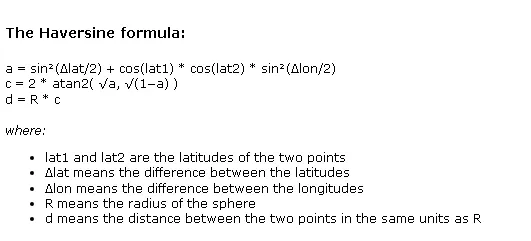

<font size="2">It takes the latitude and longitude of two points and converts the angles to radians to perform the necessary calculations. We use this formula because the dataset doesn’t provide the distance between the restaurant and the delivery location.</font>

<font size = "2">There are only latitude and longitude. So, let’s calculate it and then create a distance column in the dataset.</font>

##### There is one more python package geopy, which is used to find out the distance between two geolocations.

In [15]:
R = 6371  ##The earth's radius (in km)

def deg_to_rad(degrees):
    return degrees * (np.pi/180)

## The haversine formula
def distcalculate(lat1, lon1, lat2, lon2):
    d_lat = deg_to_rad(lat2-lat1)
    d_lon = deg_to_rad(lon2-lon1)
    a1 = np.sin(d_lat/2)**2 + np.cos(deg_to_rad(lat1))
    a2 = np.cos(deg_to_rad(lat2)) * np.sin(d_lon/2)**2
    a = a1 * a2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1-a))
    return R * c

# Create distance column & calculate the distance
df['distance'] = np.nan

for i in range(len(df)):
  df.loc[i, 'distance'] = distcalculate(df.loc[i, 'Restaurant_latitude'],
                                          df.loc[i, 'Restaurant_longitude'],
                                          df.loc[i, 'Delivery_location_latitude'],
                                          df.loc[i, 'Delivery_location_longitude'])
df.distance = df.distance.astype("int64")
df.distance.head()

0     2
1    14
2     1
3     5
4     4
Name: distance, dtype: int64

**The distance is in kilometers (km).**

In [16]:
df.to_csv("../dataset/data_after_feature_engineering.csv")

In [17]:
# Plot 1
figure = px.scatter(data_frame = df,
                    x="distance",
                    y="Time_taken(min)",
                    size="Time_taken(min)",
                    trendline="ols",
                    title = "Relationship Between Time Taken and Distance")
figure.show()

**Effect of distance on the delivery time?**

The graph shows that there is a consistent relationship between the time taken and the distance traveled for food delivery. This means that the majority of delivery partners deliver food within a range of 25–30 minutes, regardless of the distance.

In [18]:
# Plot 2
figure = px.scatter(data_frame = df,
                    x="Delivery_person_Age",
                    y="Time_taken(min)",
                    size="Time_taken(min)",
                    color = "distance",
                    trendline="ols",
                    title = "Relationship Between Delivery Partner Age and Time Taken")
figure.show()

**Is delivery partner’s age affecting delivery time or not?**

The graph shows faster food delivery when partners are younger than their older counterparts.

In [19]:
figure = px.scatter(data_frame = df,
                    x="Delivery_person_Ratings",
                    y="Time_taken(min)",
                    size="Time_taken(min)",
                    color = "distance",
                    trendline="ols",
                    title = "Relationship Between Delivery Partner Ratings and Time Taken")
figure.show()

##### **Is there any correlation between delivery time and delivery partner ratings?**

The graph shows an inverse linear relationship. The higher the rating partner, the faster the time needed to deliver food, and vice versa.

In [20]:
fig = px.box(df,
             x="Type_of_vehicle",
             y="Time_taken(min)",
             color="Type_of_order",
             title = "Relationship Between Type of Vehicle and Type of Order")
fig.show()

##### **The delivery partner’s vehicle affects the delivery time or not?**

The graph shows that the type of delivery partner’s vehicle and the type of food delivered do not significantly affect delivery time.

**Through the analysis above, we can determine that the delivery partner’s age, the delivery partner’s rating, and the distance between the restaurant and the delivery location are the features that have the most significant impact on food delivery time.**